In [469]:
import pandas as pd
import numpy as np
import os
from os import walk
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import cv2
import matplotlib.image as mpimg
import random
from pathlib import Path
import warnings
import shutil
warnings.filterwarnings('ignore')

#### Set up paths to the 2018 model folder and to the original ISIC_2019 image folder 

In [144]:
# change to path for 'Saved Models'
#ensemble_path = os.path.normpath('../input/saved-models/Saved Models')
ensemble_path = os.path.normpath('./Saved Models')

# change to path for the images
#img_dir = os.path.normpath('../input/isic-2019/ISIC_2019_Training_Input/ISIC_2019_Training_Input')
img_dir = os.path.normpath('./Data/ISIC_2019_Training_Input')

#### Reading Test Data Ground Truth CSV

In [7]:
#df_truth = pd.read_csv('../input/isic-2019/ISIC_2019_Training_GroundTruth.csv')
df_truth = pd.read_csv('ISIC_2019_Training_GroundTruth.csv')

#### Load Ensembles

In [565]:
n = 10

reconstructed_ensemble1 = [0]*n
reconstructed_ensemble2 = [0]*n
reconstructed_ensemble3 = [0]*n

for k in range(n):
    reconstructed_ensemble1[k] = keras.models.load_model(os.path.join(ensemble_path , 'Ensemble1', f"Ensemble1_model{k}"))


for k in range(n):
    reconstructed_ensemble2[k] = keras.models.load_model(os.path.join(ensemble_path , 'Ensemble2', f"Ensemble2_model{k}"))


for k in range(n):
    reconstructed_ensemble3[k] = keras.models.load_model(os.path.join(ensemble_path , 'Ensemble3', f"Ensemble3_model{k}"))

#### Function to predict an image

In [9]:
def classify(img_path,ensemble = 1):
    img = image.load_img(img_path, target_size=(128,128))
    img_array = image.img_to_array(img)
    img_array = img_array /255

    img_batch = np.expand_dims(img_array, axis=0)
    
    results = np.zeros( (1,7) ) 
    n = 10

    if ensemble == 1:
        for j in range(n):
            results = results + reconstructed_ensemble1[j].predict(img_batch)
    elif ensemble == 2:
        for j in range(n):
            results = results + reconstructed_ensemble2[j].predict(img_batch)
    else:
        for j in range(n):
            results = results + reconstructed_ensemble3[j].predict(img_batch)

    # Performing Max Voting
    results = np.argmax(results,axis = 1)

    return results

#### adding integer labels corresponding to the class names and removing 'scc' class

In [10]:
df19 = pd.melt(df_truth, id_vars=['image'],var_name='diagnosis', value_name='value')

df19 = df19[df19['value'] == 1]
df19 = df19.sort_values('image')
df19.diagnosis = df19.diagnosis.str.lower()


df19.rename(columns={'image': 'image_name', 'value': 'labels'}, inplace=True)
df19.labels = df19.diagnosis.map({
        'ak': 0,
        'bcc': 1,
        'bkl': 2,
        'df': 3,
        'mel': 4,
        'nv': 5,
        'vasc': 6
    })

df19 = df19[df19.diagnosis != 'scc']
df19.reset_index(inplace = True, drop = True)

df19.labels = df19.labels.astype(int)

def append_ext(fn):
    return fn+".jpg"

df19.image_name = df19.image_name.apply(append_ext)

#### no duplicates in image name

In [564]:
len(df19.image_name) == len(set(df19.image_name))

True

In [538]:
df19.head()

,image_name,diagnosis,labels
0,ISIC_0000000.jpg,nv,5
1,ISIC_0000001.jpg,nv,5
2,ISIC_0000002.jpg,mel,4
3,ISIC_0000003.jpg,nv,5
4,ISIC_0000004.jpg,mel,4


#### Number of images in each class in the original data set

In [494]:
df19.diagnosis.value_counts().rename_axis('diagnosis').to_frame('counts')

,counts
diagnosis,
nv,12875
mel,4522
bcc,3323
bkl,2624
ak,867
vasc,253
df,239


# Random Sampling of Original Data

#### get indexes for each class from the original dataset's dataframe separately as individual lists with each list representing a diagnosis then shuffle position of the indexes in each list (except for vasc and df)

In [230]:
nv_index = df19[df19.diagnosis == 'nv'].index.values.tolist() 
mel_index = df19[df19.diagnosis == 'mel'].index.values.tolist() 
bcc_index = df19[df19.diagnosis == 'bcc'].index.values.tolist() 
bkl_index = df19[df19.diagnosis == 'bkl'].index.values.tolist() 
ak_index = df19[df19.diagnosis == 'ak'].index.values.tolist()
vasc_index = df19[df19.diagnosis == 'vasc'].index.values.tolist()
df_index = df19[df19.diagnosis == 'df'].index.values.tolist()

random.seed(123)
random.shuffle(nv_index)
random.shuffle(mel_index)
random.shuffle(bcc_index)
random.shuffle(bkl_index)
random.shuffle(ak_index)

#### function to split a list into n-sized chunks

In [231]:
def chunks(lst, n):
    for i in range(0, len(lst), n):
        yield lst[i:i + n]

#### combining 'chunks' of size 500 of each classes' indexes to from 5 unique list consisting of the different classes index

In [232]:
classes_index = [nv_index, mel_index, bcc_index, bkl_index,ak_index,vasc_index,df_index]
num_of_sets = 5
lists_of_test_index = [[] for n in range(num_of_sets)]

for i in range(num_of_sets):
    if i < 1:
        for class_ind in classes_index:
            lists_of_test_index[i].extend(list(chunks(class_ind,500))[i])
    if i == 1:
        for class_ind in classes_index[0:5]:
            lists_of_test_index[i].extend(list(chunks(class_ind,500))[i])
    if i > 1:
        for class_ind in classes_index[0:4]:
            lists_of_test_index[i].extend(list(chunks(class_ind,500))[i])
      

#### create five separate data frames from the original truth data frame according the five list of indexes created above

In [233]:
test_df_lists= []

for i in range(num_of_sets):
    test_df_lists.append(df19.iloc[lists_of_test_index[i]])

#### display the number of images in each class for the 5 data frames which will represent our 5 testing data sets

In [495]:
for i in range(num_of_sets):
    print('test data set ' + str(i+1))
    display(test_df_lists[i].diagnosis.value_counts().rename_axis('diagnosis').to_frame('counts'))

test data set 1


,counts
diagnosis,
nv,500
mel,500
bcc,500
bkl,500
ak,500
vasc,253
df,239


test data set 2


,counts
diagnosis,
nv,500
mel,500
bcc,500
bkl,500
ak,367


test data set 3


,counts
diagnosis,
nv,500
mel,500
bcc,500
bkl,500


test data set 4


,counts
diagnosis,
nv,500
mel,500
bcc,500
bkl,500


test data set 5


,counts
diagnosis,
nv,500
mel,500
bcc,500
bkl,500


#### Verify that no single images exist in more than one data set

In [562]:
for i in range(num_of_sets):
    for j in range(num_of_sets):
        if (i != j) & (i < j):
            print(set(test_df_lists[i].image_name).intersection(set(test_df_lists[j].image_name)))

set()
set()
set()
set()
set()
set()
set()
set()
set()
set()


### copy images from the original data set to create the sampled test data set on local machine according to the 5 dataframes created above
The prediction method does not use the data set generated below but fetches images from the original data set according to the 5 dataframes created above. The data set generated below is to make it easier to look at the images in each of the generated dataset and for each of the classes on the local machine.

In [470]:
root = '2019_sampled_test_set'
midFolders = ['1','2','3','4','5']

for i in range(num_of_sets):
    endFolders = list(set(test_df_lists[i].diagnosis))
    for endFolder in endFolders:
        dir = os.path.join(root, midFolders[i], endFolder)
        if (not os.path.exists(dir)):
            os.makedirs(dir)

for i in range(num_of_sets):
    df_work = test_df_lists[i]
    endFolders = list(set(df_work.diagnosis))
    for x in df_work.image_name:
        diag = df_work[df_work.image_name == x]['diagnosis'].item()
        for endFolder in endFolders:
            src = os.path.join(img_dir,x)
            dst = os.path.join(root, midFolders[i], endFolder)
            if  (diag == endFolder) & (not os.path.exists(os.path.join(dst,x))):
                shutil.copy(src, dst)

# Making Predictions for the 5 sampled data sets using 2018 Ensemble 3 Model

In [236]:
label_map = {
        '0' :'ak',
        '1' : 'bcc',
        '2' :'bkl',
        '3' : 'df',
        '4' : 'mel',
        '5' : 'nv',
        '6' : 'vasc'
    }

In [237]:
%%time
y_pred3_sub = [[] for n in range(num_of_sets)]
overall_accuracy = []
recall_list = [[] for n in range(num_of_sets)]
precision_list = [[] for n in range(num_of_sets)]
f1_list = [[] for n in range(num_of_sets)]
labels_list = [[] for n in range(num_of_sets)]

for i in range(num_of_sets):
    for x in test_df_lists[i].image_name:
        y_pred3_sub[i].extend(classify(os.path.join(img_dir,x),3))
    print("ensemble 3 eval using test data set #" + str(i+1))
    print('Confusion Matrix')
    print(confusion_matrix(test_df_lists[i].labels,y_pred3_sub[i]))
    print('Classification Report')
    unique_lab_coded = list(map(str, list(set(y_pred3_sub[i]))))
    target_names = [label_map.get(x) for x in unique_lab_coded]    
    print(classification_report(test_df_lists[i].labels,y_pred3_sub[i],target_names=target_names))
    report = classification_report(test_df_lists[i].labels,y_pred3_sub[i], output_dict=True  )
    overall_accuracy.extend([report['accuracy']])
    for lab in range(len(target_names)):
        recall_list[i].extend([report[str(lab)]['recall']])
        precision_list[i].extend([report[str(lab)]['precision']])
        f1_list[i].extend([report[str(lab)]['f1-score']])
        labels_list[i].extend([target_names[lab]])
        

ensemble 3 eval using test data set #1
Confusion Matrix
[[101  67  70  11  14 229   8]
 [ 23 192  43  19  16 195  12]
 [ 12  32 207  13  13 223   0]
 [  4  13  11 133   1  76   1]
 [ 10  16  50   6 156 253   9]
 [  2   9  35   6  13 433   2]
 [  2  33   5   9   5  72 127]]
Classification Report
              precision    recall  f1-score   support

          ak       0.66      0.20      0.31       500
         bcc       0.53      0.38      0.45       500
         bkl       0.49      0.41      0.45       500
          df       0.68      0.56      0.61       239
         mel       0.72      0.31      0.43       500
          nv       0.29      0.87      0.44       500
        vasc       0.80      0.50      0.62       253

    accuracy                           0.45      2992
   macro avg       0.59      0.46      0.47      2992
weighted avg       0.57      0.45      0.45      2992

ensemble 3 eval using test data set #2
Confusion Matrix
[[ 71  53  48  15   7 170   3]
 [ 24 185  43  24  1

/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leo

ensemble 3 eval using test data set #3
Confusion Matrix
[[  0   0   0   0   0   0   0]
 [ 36 195  56  26  14 166   7]
 [ 22  47 211  14  17 187   2]
 [  0   0   0   0   0   0   0]
 [  6  17  53   5 147 258  14]
 [  2  15  47   4  16 416   0]
 [  0   0   0   0   0   0   0]]
Classification Report
              precision    recall  f1-score   support

          ak       0.00      0.00      0.00         0
         bcc       0.71      0.39      0.50       500
         bkl       0.57      0.42      0.49       500
          df       0.00      0.00      0.00         0
         mel       0.76      0.29      0.42       500
          nv       0.41      0.83      0.54       500
        vasc       0.00      0.00      0.00         0

    accuracy                           0.48      2000
   macro avg       0.35      0.28      0.28      2000
weighted avg       0.61      0.48      0.49      2000



/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leo

ensemble 3 eval using test data set #4
Confusion Matrix
[[  0   0   0   0   0   0   0]
 [ 22 193  42  17  11 206   9]
 [ 14  40 222  10  10 203   1]
 [  0   0   0   0   0   0   0]
 [ 13  20  50   5 144 261   7]
 [  5  14  37   8  26 408   2]
 [  0   0   0   0   0   0   0]]
Classification Report
              precision    recall  f1-score   support

          ak       0.00      0.00      0.00         0
         bcc       0.72      0.39      0.50       500
         bkl       0.63      0.44      0.52       500
          df       0.00      0.00      0.00         0
         mel       0.75      0.29      0.42       500
          nv       0.38      0.82      0.52       500
        vasc       0.00      0.00      0.00         0

    accuracy                           0.48      2000
   macro avg       0.36      0.28      0.28      2000
weighted avg       0.62      0.48      0.49      2000



/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leo

ensemble 3 eval using test data set #5
Confusion Matrix
[[  0   0   0   0   0   0   0]
 [ 21 190  45  20  13 202   9]
 [ 22  25 222  10  17 204   0]
 [  0   0   0   0   0   0   0]
 [ 10  15  55   7 134 278   1]
 [  1  21  33   6  18 421   0]
 [  0   0   0   0   0   0   0]]
Classification Report
              precision    recall  f1-score   support

          ak       0.00      0.00      0.00         0
         bcc       0.76      0.38      0.51       500
         bkl       0.63      0.44      0.52       500
          df       0.00      0.00      0.00         0
         mel       0.74      0.27      0.39       500
          nv       0.38      0.84      0.52       500
        vasc       0.00      0.00      0.00         0

    accuracy                           0.48      2000
   macro avg       0.36      0.28      0.28      2000
weighted avg       0.62      0.48      0.49      2000

CPU times: user 53min 14s, sys: 8min 55s, total: 1h 2min 9s
Wall time: 2h 4min 29s


/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leoliang/opt/anaconda3/envs/tf/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/leo

## Visualization of the Prediction Metrics

#### Average overall accuracy

In [540]:
np.average(overall_accuracy)

0.4684332391235097

#### create a list of data frames that includes the metrics for each sampled data set

In [541]:
list_df_metrics = [[] for n in range(num_of_sets)]

for i in range(num_of_sets):
    list_df_metrics[i] = pd.DataFrame(list(zip(recall_list[i],
                                               precision_list[i],
                                               f1_list[i],
                                               labels_list[i],
                                              list(np.repeat(str(i+1),len(labels_list[i]))))),
               columns =['recall', 'precision','f1_score','diagnosis', 'dataset'])

#### create data frames of the overall accuracy for each sampled data set

In [543]:
df_accuracy = pd.DataFrame(list(zip([str(x+1) for x in list(range(num_of_sets))], 
                                   overall_accuracy)),
                          columns =['dataset', 'accuracy'])

df_accuracy

,dataset,accuracy
0,1,0.450869
1,2,0.439797
2,3,0.484500
3,4,0.483500
4,5,0.483500


#### plot overall accuracy

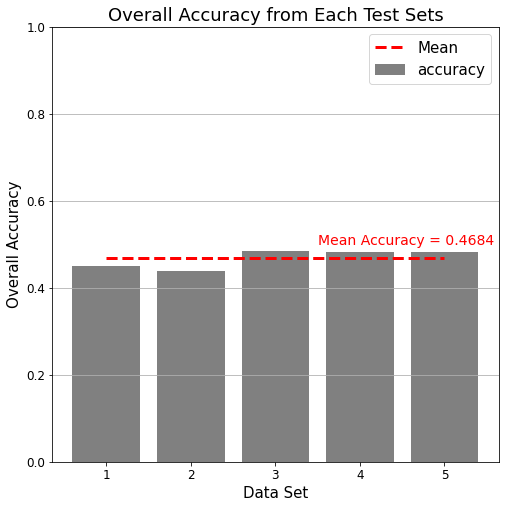

In [428]:
y_mean = [np.mean(df_accuracy.accuracy)]*len(df_accuracy.dataset)


fig,ax = plt.subplots(figsize=(8,8))
data_bar = ax.bar(df_accuracy.dataset, df_accuracy.accuracy, label = 'accuracy',color = 'gray')
mean_line = ax.plot(df_accuracy.dataset,y_mean, label='Mean', linestyle='--', color = 'red', linewidth = 3)
legend = ax.legend(loc='upper right',fontsize = 15)
ax.text(2.5,.5,'Mean Accuracy = ' + str(round(y_mean[0],4)), color = 'red', fontsize = 14)
plt.xlabel('Data Set',fontsize = 15)
plt.ylabel('Overall Accuracy',fontsize = 15)
plt.title('Overall Accuracy from Each Test Sets', fontsize = 18)
plt.ylim(top=1)
plt.grid(axis = 'y')

plt.show()

#### combine the list of metrics dataframe created above to form one data frame

In [498]:
df_metrics = pd.concat(list_df_metrics)
df_metrics = df_metrics[(df_metrics.recall != 0) & (df_metrics.precision != 0)]
df_metrics

,recall,precision,f1_score,diagnosis,dataset
0,0.202000,0.655844,0.308869,ak,1
1,0.384000,0.530387,0.445476,bcc,1
2,0.414000,0.491686,0.449511,bkl,1
3,0.556485,0.675127,0.610092,df,1
4,0.312000,0.715596,0.434540,mel,1
5,0.866000,0.292370,0.437153,nv,1
6,0.501976,0.798742,0.616505,vasc,1
0,0.193460,0.577236,0.289796,ak,2
1,0.370000,0.620805,0.463659,bcc,2
2,0.412000,0.552279,0.471936,bkl,2


#### plot metrics for each dataset and for each class

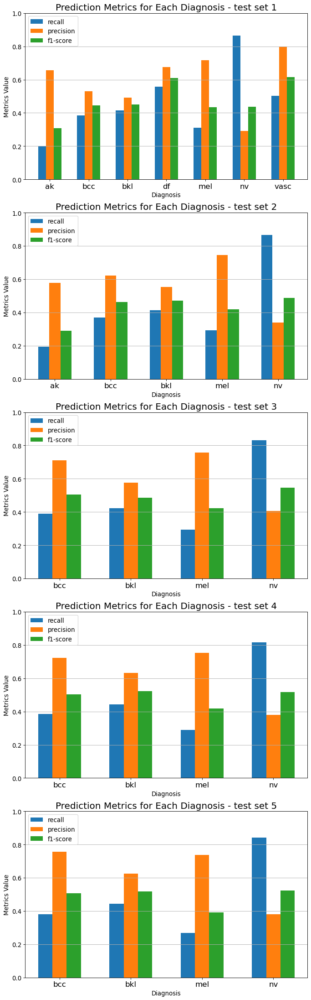

In [425]:
plt.figure(figsize=(10,35), dpi=80)
for i in list(range(1,6)):
    
    x = df_metrics[df_metrics.dataset == str(i)].dianosis
    y_recall = df_metrics[df_metrics.dataset == str(i)].recall
    y_precision = df_metrics[df_metrics.dataset == str(i)].precision
    y_f1_score = df_metrics[df_metrics.dataset == str(i)].f1_score
    width = 0.2
    ind = np.arange(len(x))

    # Draw first subplot

    plt.subplot(5, 1, i)
    plt.bar(ind, y_recall, width=width, label = 'recall')
    plt.bar(ind + width, y_precision, width=width, label = 'precision')
    plt.bar(ind + width + width, y_f1_score, width=width, label = 'f1-score')
    legend = plt.legend(loc='upper left')
    plt.ylim(top=1)
    plt.xticks(ind + width , x, fontsize = 15)
    plt.xlabel('Diagnosis')
    plt.ylabel('Metrics Value')
    plt.title('Prediction Metrics for Each Diagnosis - test set ' + str(i), fontsize = 18)
    plt.grid(axis = 'y')
    
    
plt.show()

#### create data frame for average metrics value in each class

In [511]:
df_metrics_avg = df_metrics.groupby('diagnosis')[['recall','precision','f1_score']].mean().reset_index(level=0)
df_metrics_avg

,diagnosis,recall,precision,f1_score
0,ak,0.197730,0.616540,0.299332
1,bcc,0.382000,0.668538,0.484452
2,bkl,0.427200,0.575346,0.489844
3,df,0.556485,0.675127,0.610092
4,mel,0.290800,0.741683,0.417492
5,nv,0.844400,0.359250,0.502269
6,vasc,0.501976,0.798742,0.616505


#### plot average metrics value for each class

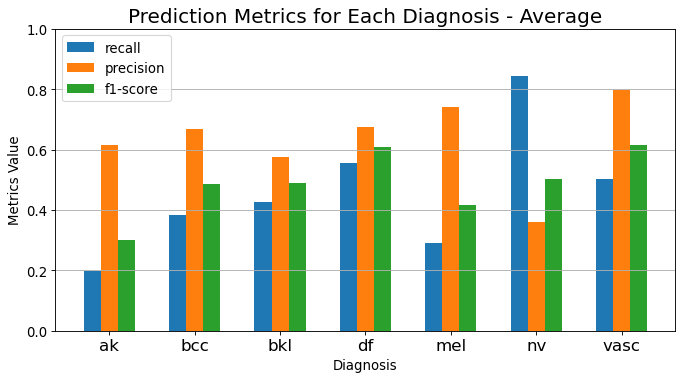

In [523]:
plt.figure(figsize=(10,5), dpi=80)
x_avg = df_metrics_avg.diagnosis
y_recall_avg = df_metrics_avg.recall
y_precision_avg = df_metrics_avg.precision
y_f1_score_avg = df_metrics_avg.f1_score
width = 0.2
ind = np.arange(len(x_avg))

plt.bar(ind, y_recall_avg, width=width, label = 'recall')
plt.bar(ind + width, y_precision_avg, width=width, label = 'precision')
plt.bar(ind + width + width, y_f1_score_avg, width=width, label = 'f1-score')
legend = plt.legend(loc='upper left')
plt.ylim(top=1)
plt.xticks(ind + width , x_avg, fontsize = 15)
plt.xlabel('Diagnosis')
plt.ylabel('Metrics Value')
plt.title('Prediction Metrics for Each Diagnosis - Average', fontsize = 18)
plt.grid(axis = 'y')

    
plt.show()

# Prediction result images samples

#### function to show images samples of incorrect and correct prediction in a particular dataset, and for a specific class

In [534]:
def image_result(set_num = 0, diagnosis = 'ak' , row = 2, col = 5):
    df19 = test_df_lists[set_num]
    df19['predictions3'] = y_pred3_sub[set_num]
    false3 = df19[(df19.diagnosis == diagnosis) &
              (df19.labels != df19.predictions3)].reset_index()
    true3 = df19[(df19.diagnosis == diagnosis) &
              (df19.labels == df19.predictions3)].reset_index()
    

    fig = plt.figure(figsize=(15, 6))
    columns = col
    rows = row
    ax = []
    for i in range(columns*rows):
        img = mpimg.imread(os.path.join(img_dir,false3.image_name[i]))
        ax.append( fig.add_subplot(rows, columns, i+1) )
        ax[-1].set_title("actual: "+str(false3.labels[i]) + " | predicted: " + str(false3.predictions3[i]),
                        fontsize = 11) 
        plt.imshow(img)
    fig.suptitle("incorrect predictions: " + diagnosis + " images (ensemble 3) sample - test set " + str(set_num + 1),
                 fontsize = 14)
    plt.show()
    
    
    
    fig = plt.figure(figsize=(15, 6))
    columns = col
    rows = row
    ax = []
    for i in range(columns*rows):
        img = mpimg.imread(os.path.join(img_dir,true3.image_name[i]))
        ax.append( fig.add_subplot(rows, columns, i+1) )
        ax[-1].set_title("actual: "+str(true3.labels[i]) + " | predicted: " + str(true3.predictions3[i]),
                        fontsize = 11) 
        plt.imshow(img)
    fig.suptitle("correct predictions: " + diagnosis + " images (ensemble 3) sample - test set " + str(set_num + 1),
                 fontsize = 14)
    plt.show()

#### display prediction results image samples for all classes in all 5 datasets

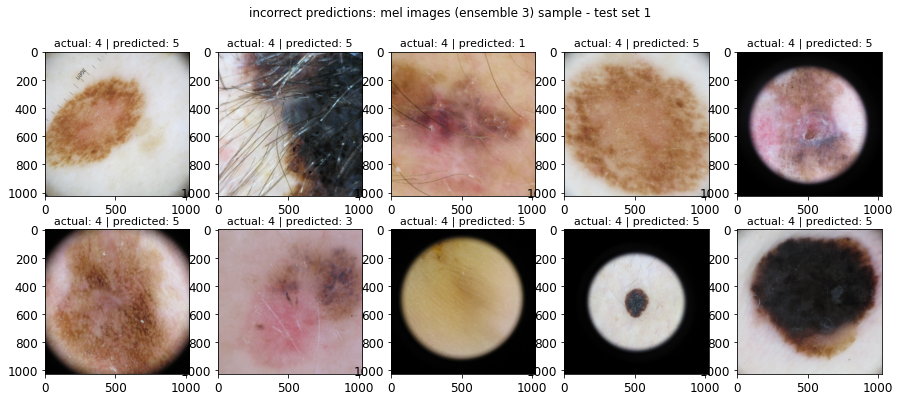

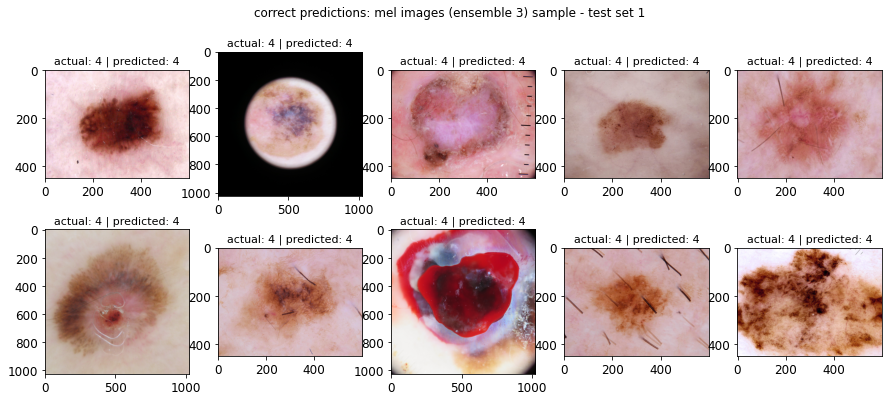

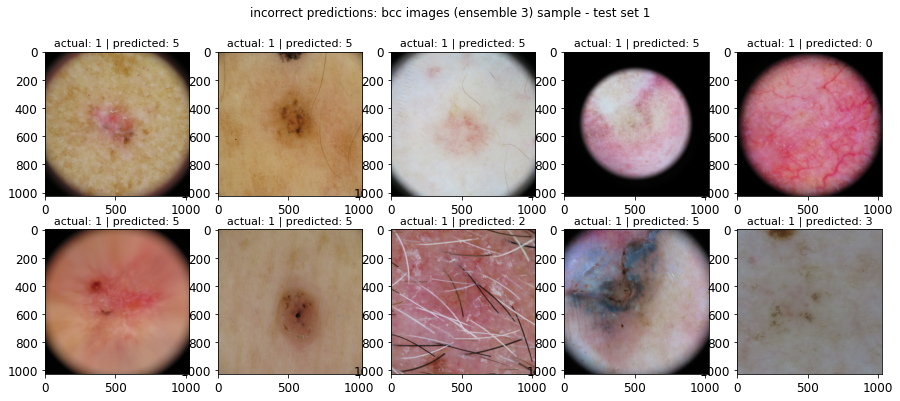

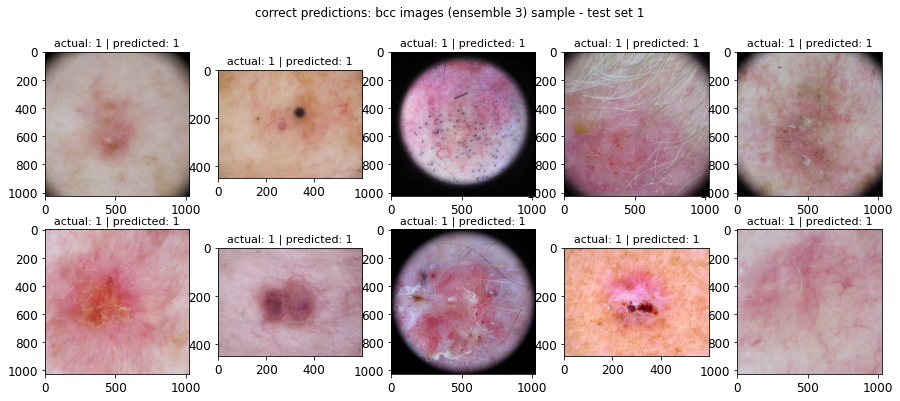

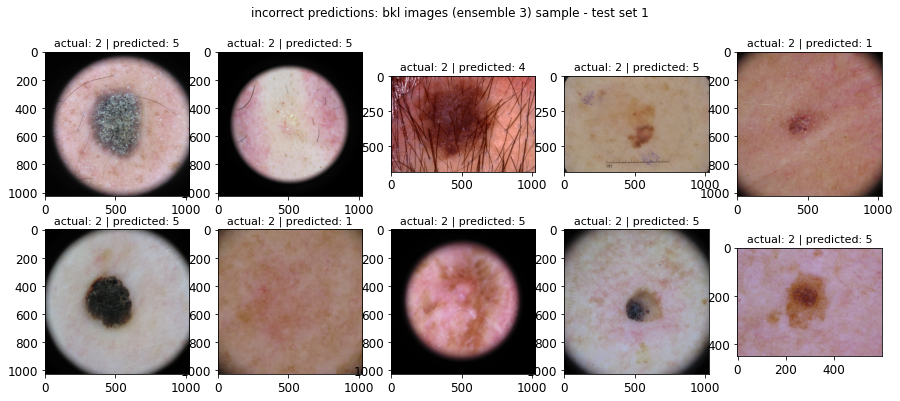

...

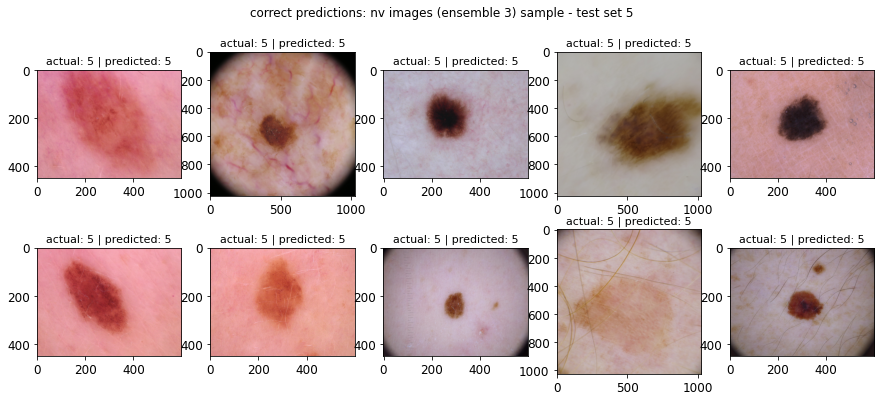

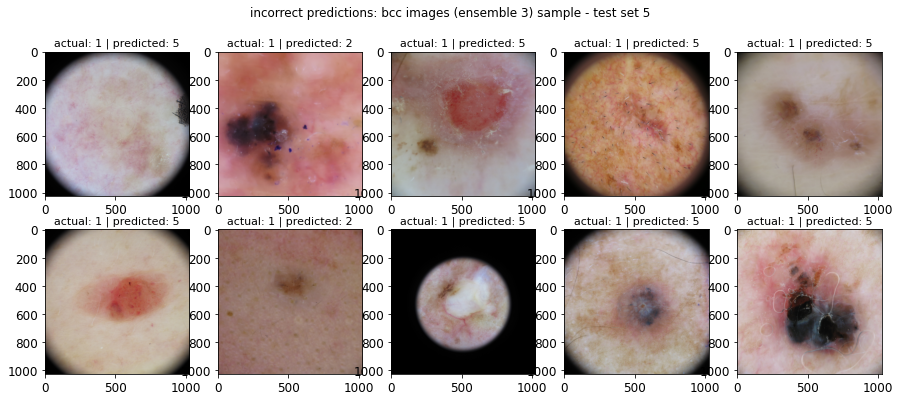

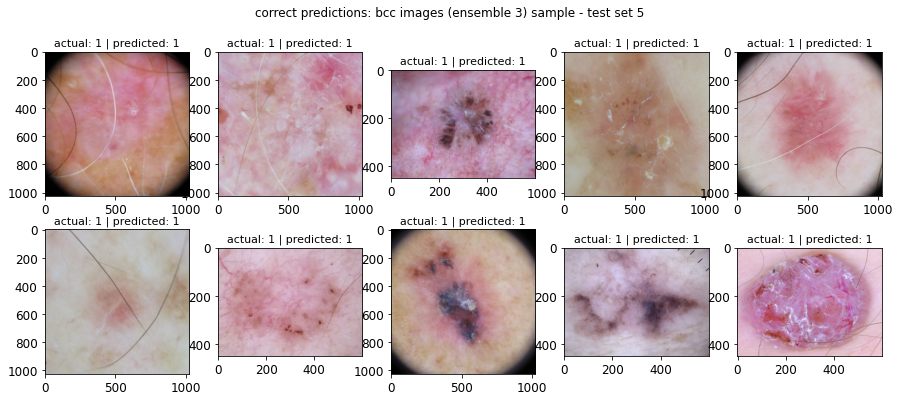

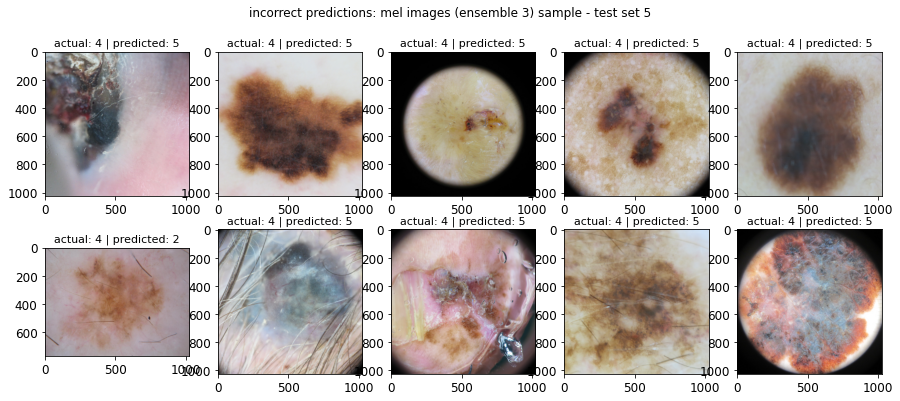

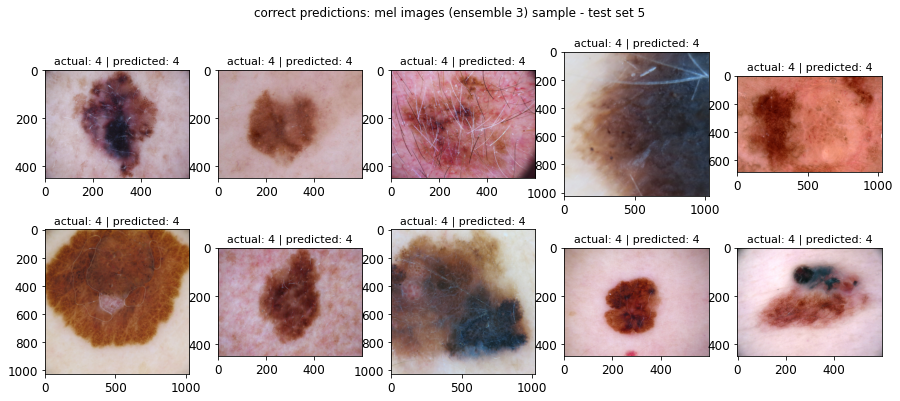

In [537]:
for i in range(num_of_sets):
    diag_list = list(set(test_df_lists[i].diagnosis))
    for diag in diag_list:
        image_result(set_num = i, diagnosis = diag)